<a href="https://colab.research.google.com/github/Nehzienae/Nehzienae/blob/main/BECKY_BISSOUA_DATA%20SCIENCE%20PROJECT.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# *NEH BECKYLOR BISSOUA PROJECT*
Data Science in Restaurant
Analytics: Capstone Project

# ** Data Exploration**
1. Dataset Overview
: Explore dataset dimensions. Check
for missing values. Perform data
type conversions as needed.
2. Target Variable:
Analyze "Aggregate rating"
distribution. Address any class
imbalances.
3. Descriptive Analysis:
Calculate statistics for numerical
columns. Explore categorical
variables. Identify top 5 cuisines
and cities.

In [1]:
# Importing Libraries

import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
import folium
from folium.plugins import HeatMap

In [2]:
# Loading the dataset

url = 'https://raw.githubusercontent.com/Oyeniran20/axia_class_cohort_7/refs/heads/main/Dataset%20.csv'
data = pd.read_csv(url)

In [3]:

data.head()

,Restaurant ID,Restaurant Name,Country Code,City,Address,Locality,Locality Verbose,Longitude,Latitude,Cuisines,...,Currency,Has Table booking,Has Online delivery,Is delivering now,Switch to order menu,Price range,Aggregate rating,Rating color,Rating text,Votes
0,6317637,Le Petit Souffle,162,Makati City,"Third Floor, Century City Mall, Kalayaan Avenu...","Century City Mall, Poblacion, Makati City","Century City Mall, Poblacion, Makati City, Mak...",121.027535,14.565443,"French, Japanese, Desserts",...,Botswana Pula(P),Yes,No,No,No,3,4.8,Dark Green,Excellent,314
1,6304287,Izakaya Kikufuji,162,Makati City,"Little Tokyo, 2277 Chino Roces Avenue, Legaspi...","Little Tokyo, Legaspi Village, Makati City","Little Tokyo, Legaspi Village, Makati City, Ma...",121.014101,14.553708,Japanese,...,Botswana Pula(P),Yes,No,No,No,3,4.5,Dark Green,Excellent,591
2,6300002,Heat - Edsa Shangri-La,162,Mandaluyong City,"Edsa Shangri-La, 1 Garden Way, Ortigas, Mandal...","Edsa Shangri-La, Ortigas, Mandaluyong City","Edsa Shangri-La, Ortigas, Mandaluyong City, Ma...",121.056831,14.581404,"Seafood, Asian, Filipino, Indian",...,Botswana Pula(P),Yes,No,No,No,4,4.4,Green,Very Good,270
3,6318506,Ooma,162,Mandaluyong City,"Third Floor, Mega Fashion Hall, SM Megamall, O...","SM Megamall, Ortigas, Mandaluyong City","SM Megamall, Ortigas, Mandaluyong City, Mandal...",121.056475,14.585318,"Japanese, Sushi",...,Botswana Pula(P),No,No,No,No,4,4.9,Dark Green,Excellent,365
4,6314302,Sambo Kojin,162,Mandaluyong City,"Third Floor, Mega Atrium, SM Megamall, Ortigas...","SM Megamall, Ortigas, Mandaluyong City","SM Megamall, Ortigas, Mandaluyong City, Mandal...",121.057508,14.584450,"Japanese, Korean",...,Botswana Pula(P),Yes,No,No,No,4,4.8,Dark Green,Excellent,229


In [ ]:
# Displaying the dataset shape

print("Dataset Shape:", data.shape)

Dataset Shape: (9551, 21)


In [ ]:
# Checking for any missing values

missing_values = data.isnull().sum()
missing_percentage = (missing_values / len(data)) * 100
print("\nMissing Values:")
print(pd.DataFrame({'Missing Values': missing_values, 'Percentage': missing_percentage}))


Missing Values:
                      Missing Values  Percentage
Restaurant ID                      0    0.000000
Restaurant Name                    0    0.000000
Country Code                       0    0.000000
City                               0    0.000000
Address                            0    0.000000
Locality                           0    0.000000
Locality Verbose                   0    0.000000
Longitude                          0    0.000000
Latitude                           0    0.000000
Cuisines                           9    0.094231
Average Cost for two               0    0.000000
Currency                           0    0.000000
Has Table booking                  0    0.000000
Has Online delivery                0    0.000000
Is delivering now                  0    0.000000
Switch to order menu               0    0.000000
Price range                        0    0.000000
Aggregate rating                   0    0.000000
Rating color                       0    0.000000
Rat

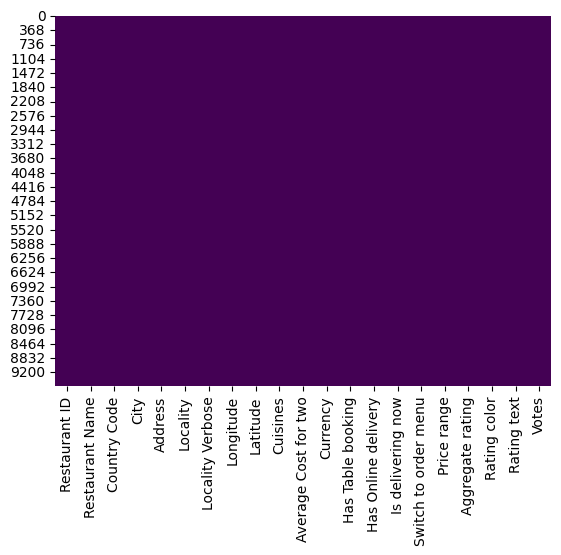

In [ ]:
# Visualizing missing data using a heatmap

sns.heatmap(data.isnull(), cbar=False, cmap="viridis")
plt.show ()


In [ ]:
# Removing any rows containing missing values in my dataset

data_cleaned = data.dropna()
print("\nCleaned Data:")
print(data_cleaned.head())



Cleaned Data:
   Restaurant ID         Restaurant Name  Country Code              City  \
0        6317637        Le Petit Souffle           162       Makati City   
1        6304287        Izakaya Kikufuji           162       Makati City   
2        6300002  Heat - Edsa Shangri-La           162  Mandaluyong City   
3        6318506                    Ooma           162  Mandaluyong City   
4        6314302             Sambo Kojin           162  Mandaluyong City   

                                             Address  \
0  Third Floor, Century City Mall, Kalayaan Avenu...   
1  Little Tokyo, 2277 Chino Roces Avenue, Legaspi...   
2  Edsa Shangri-La, 1 Garden Way, Ortigas, Mandal...   
3  Third Floor, Mega Fashion Hall, SM Megamall, O...   
4  Third Floor, Mega Atrium, SM Megamall, Ortigas...   

                                     Locality  \
0   Century City Mall, Poblacion, Makati City   
1  Little Tokyo, Legaspi Village, Makati City   
2  Edsa Shangri-La, Ortigas, Mandaluyong Cit

In [ ]:
# Handing missing values. The cusines column has some missing values so i replaced them with unknown

data["Cuisines"] = data["Cuisines"].fillna("Unknown")

In [ ]:
# Here if other missing values exist, it should consider imputing numerical values with the median or removing rows with extreme missing data. I also filled numerical missing values with median

num_cols = data.select_dtypes(include=["number"]).columns
data[num_cols] = data[num_cols].fillna(data[num_cols].median())

In [ ]:
# Displaying data types

print("\nData Types:")
print(data.dtypes)


Data Types:
Restaurant ID             int64
Restaurant Name          object
Country Code              int64
City                     object
Address                  object
Locality                 object
Locality Verbose         object
Longitude               float64
Latitude                float64
Cuisines                 object
Average Cost for two      int64
Currency                 object
Has Table booking        object
Has Online delivery      object
Is delivering now        object
Switch to order menu     object
Price range               int64
Aggregate rating        float64
Rating color             object
Rating text              object
Votes                     int64
dtype: object


In [11]:
print(data.columns)

Index(['Restaurant ID', 'Restaurant Name', 'Country Code', 'City', 'Address',
       'Locality', 'Locality Verbose', 'Longitude', 'Latitude', 'Cuisines',
       'Average Cost for two', 'Currency', 'Has Table booking',
       'Has Online delivery', 'Is delivering now', 'Switch to order menu',
       'Price range', 'Aggregate rating', 'Rating color', 'Rating text',
       'Votes'],
      dtype='object')


In [ ]:
# Aggregate rating analysis. Checking what the distribution of ratings.

print("\nAggregate Rating Stats:")
print(data["Aggregate rating"].describe())


Aggregate Rating Stats:
count    9551.000000
mean        2.666370
std         1.516378
min         0.000000
25%         2.500000
50%         3.200000
75%         3.700000
max         4.900000
Name: Aggregate rating, dtype: float64


In [ ]:
# The summary statistics for the numerical columns

print("\nDescriptive Statistics:")
data.describe()



Descriptive Statistics:


,Restaurant ID,Country Code,Longitude,Latitude,Average Cost for two,Price range,Aggregate rating,Votes
count,9.551000e+03,9551.000000,9551.000000,9551.000000,9551.000000,9551.000000,9551.000000,9551.000000
mean,9.051128e+06,18.365616,64.126574,25.854381,1199.210763,1.804837,2.666370,156.909748
std,8.791521e+06,56.750546,41.467058,11.007935,16121.183073,0.905609,1.516378,430.169145
min,5.300000e+01,1.000000,-157.948486,-41.330428,0.000000,1.000000,0.000000,0.000000
25%,3.019625e+05,1.000000,77.081343,28.478713,250.000000,1.000000,2.500000,5.000000
50%,6.004089e+06,1.000000,77.191964,28.570469,400.000000,2.000000,3.200000,31.000000
75%,1.835229e+07,1.000000,77.282006,28.642758,700.000000,2.000000,3.700000,131.000000
max,1.850065e+07,216.000000,174.832089,55.976980,800000.000000,4.000000,4.900000,10934.000000


In [6]:
# Count the frequency of restaurants in each city and get the top 10
city_counts = data['City'].value_counts().head(10)
city_counts

,count
City,
New Delhi,5473
Gurgaon,1118
Noida,1080
Faridabad,251
Ghaziabad,25
Bhubaneshwar,21
Lucknow,21
Ahmedabad,21
Amritsar,21


In [ ]:
# Top five cuisines

top_cuisines = data["Cuisines"].value_counts().head(5)
print("\nTop 5 Cuisines:")
print(top_cuisines)


Top 5 Cuisines:
Cuisines
North Indian             936
North Indian, Chinese    511
Fast Food                354
Chinese                  354
North Indian, Mughlai    334
Name: count, dtype: int64


In [ ]:
# Top five cities with resturant

top_cities = data["City"].value_counts().head(5)
print("\nTop 5 Cities:")
print(top_cities)


Top 5 Cities:
City
New Delhi    5473
Gurgaon      1118
Noida        1080
Faridabad     251
Ghaziabad      25
Name: count, dtype: int64


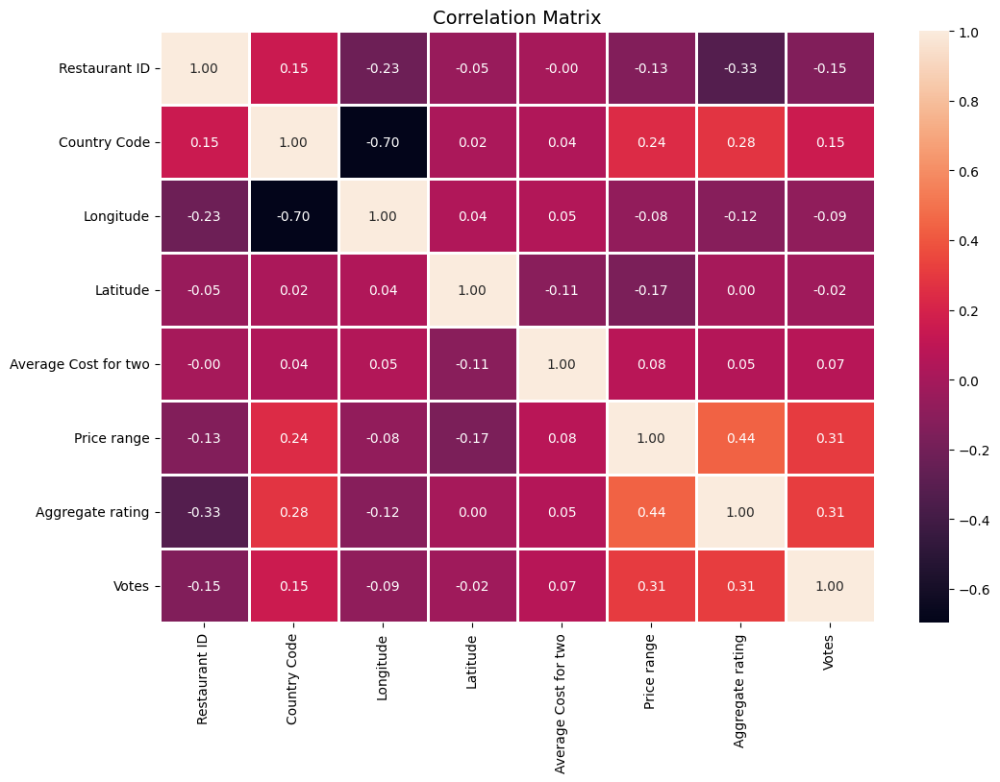

In [ ]:
# A correlation matrix with better styling

plt.figure(figsize=(12, 8))
sns.heatmap(data.select_dtypes(include=['number']).corr(), annot=True, linewidths=1, fmt=".2f")
plt.title("Correlation Matrix", fontsize=14)
plt.show()

# IN: I see ratings have a weak correlation with votes, suggesting that popularity (votes) doesn't always reflect quality (ratings)

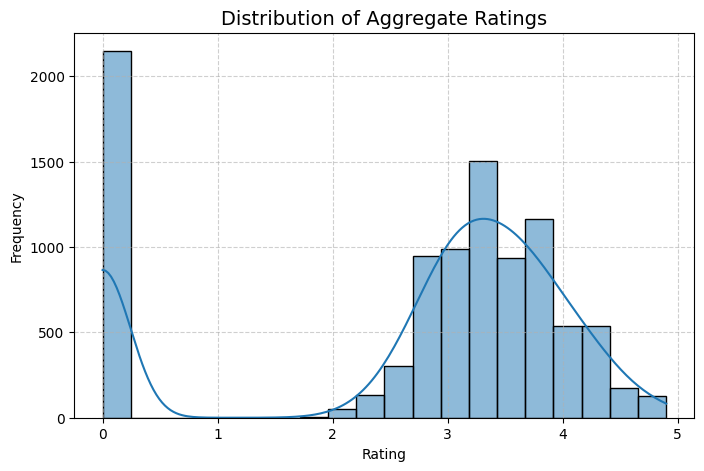

In [ ]:
# Visualizing how ratings are distributed in the dataset and identify common rating values.

plt.figure(figsize=(8, 5))
sns.histplot(data["Aggregate rating"], bins=20, kde=True, edgecolor='black')
plt.title("Distribution of Aggregate Ratings", fontsize=14)
plt.xlabel("Rating")
plt.ylabel("Frequency")
plt.grid(True, linestyle='--', alpha=0.6)
plt.show()

# IN: I noticed most of the ratings are set around the 2.5 to 3.5 range, indicating average customer satisfaction

In [ ]:
# The votes column is highly skewed, so i am applying log transformation to normalize it. Avoiding log errors, removing missing daat for votes and log transformation

data["Votes"] = data["Votes"].replace(0, np.nan)
data.dropna(subset=["Votes"], inplace=True)
data["log_Votes"] = np.log1p(data["Votes"])

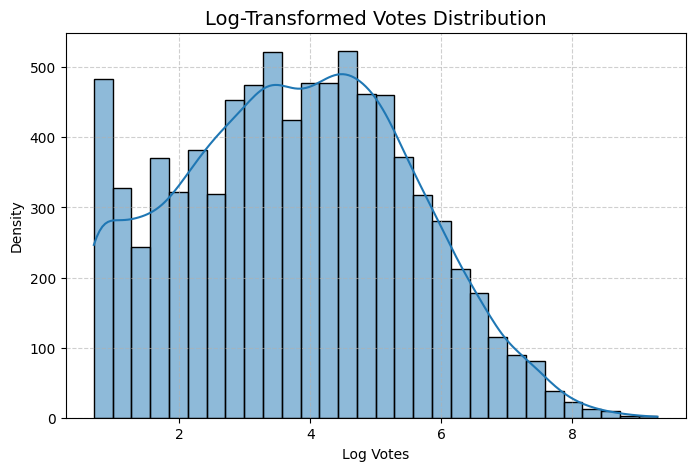

In [ ]:
# IN: After log transformation, the votes distribution is now more balanced, making it easier to analyse trends

data["log_Votes"] = np.log1p(data["Votes"])
plt.figure(figsize=(8, 5))
sns.histplot(data["log_Votes"], kde=True, bins=30, edgecolor='black')
plt.title("Log-Transformed Votes Distribution", fontsize=14)
plt.xlabel("Log Votes")
plt.ylabel("Density")
plt.grid(True, linestyle='--', alpha=0.6)
plt.show()

In [ ]:
# Average ratings by cuisine

cuisine_ratings = data.groupby("Cuisines")["Aggregate rating"].mean().sort_values(ascending=False).head(5)
print("\nTop 5 Cuisines by Average Rating:")
print(cuisine_ratings)


Top 5 Cuisines by Average Rating:
Cuisines
American, Caribbean, Seafood    4.9
American, BBQ, Sandwich         4.9
American, Burger, Grill         4.9
World Cuisine                   4.9
American, Coffee and Tea        4.9
Name: Aggregate rating, dtype: float64


In [ ]:
# Average ratings by city

city_ratings = data.groupby("City")["Aggregate rating"].mean().sort_values(ascending=False).head(5)
print("\nTop 5 Cities by Average Rating:")
print(city_ratings)



Top 5 Cities by Average Rating:
City
Inner City          4.900000
Quezon City         4.800000
Makati City         4.650000
Pasig City          4.633333
Mandaluyong City    4.625000
Name: Aggregate rating, dtype: float64


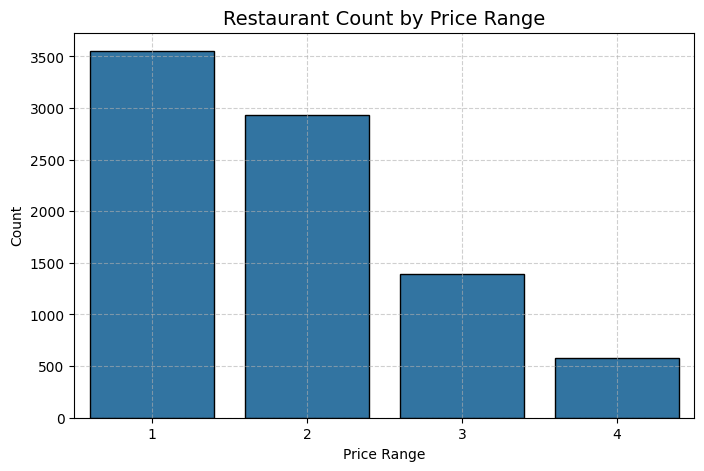

In [ ]:
# Count of restaurants by price range

plt.figure(figsize=(8, 5))
sns.countplot(x=data["Price range"], edgecolor='black')
plt.title("Restaurant Count by Price Range", fontsize=14)
plt.xlabel("Price Range")
plt.ylabel("Count")
plt.grid(True, linestyle='--', alpha=0.6)
plt.show()

# IN: Most of the restaurants fall within the lower price ranges, showing affordability is a key factor in this dataset

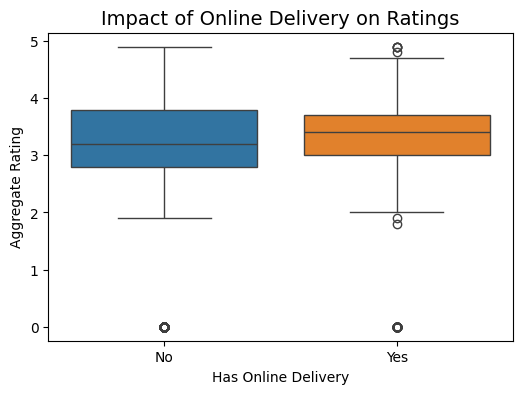

In [ ]:
# Online Delivery Vs Ratings

plt.figure(figsize=(6, 4))
sns.boxplot(x="Has Online delivery", y="Aggregate rating", hue="Has Online delivery", data=data, legend=False)
plt.title("Impact of Online Delivery on Ratings", fontsize=14)
plt.xlabel("Has Online Delivery")
plt.ylabel("Aggregate Rating")
plt.show()

# IN: There is no significant difference in ratings between restaurants that offer online delivery and those that don’t, showing that online delivery may not be a key factor in customer satisfaction.

#  Data Visualization

Visualizations: Creating histograms,
bar plots, and box
plots of ratings.
Compare average
ratings across
cuisines and cities.

Geospatial
Analysis: Map restaurant
locations using
coordinates.
Analyze distribution
across cities.
Correlate location
with ratings.

Additional
Analysis: Identifying outliers and
their effects.
Determine
relationship
between votes and
ratings.

In [ ]:
# I am converting ratings and votes to numeric, doing this just in case there are any weird values

data["Aggregate rating"] = pd.to_numeric(data["Aggregate rating"], errors='coerce')
data["Votes"] = pd.to_numeric(data["Votes"], errors='coerce')

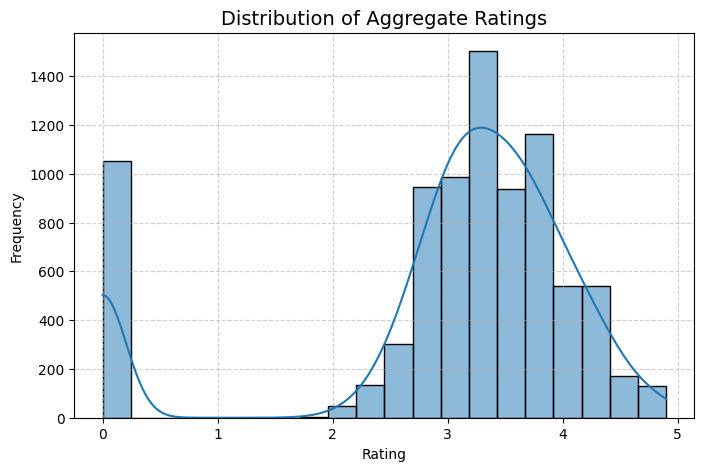

In [ ]:
# Distribution of Ratings. Are the restaurants rated high, low, or in between?

plt.figure(figsize=(8, 5))
sns.histplot(data["Aggregate rating"], bins=20, kde=True, edgecolor='black')
plt.title("Distribution of Aggregate Ratings", fontsize=14)
plt.xlabel("Rating")
plt.ylabel("Frequency")
plt.grid(True, linestyle='--', alpha=0.6)
plt.show()

# IN: Majority of restaurants have ratings between 2.5 and 4.0, which means that most are rated average to good.

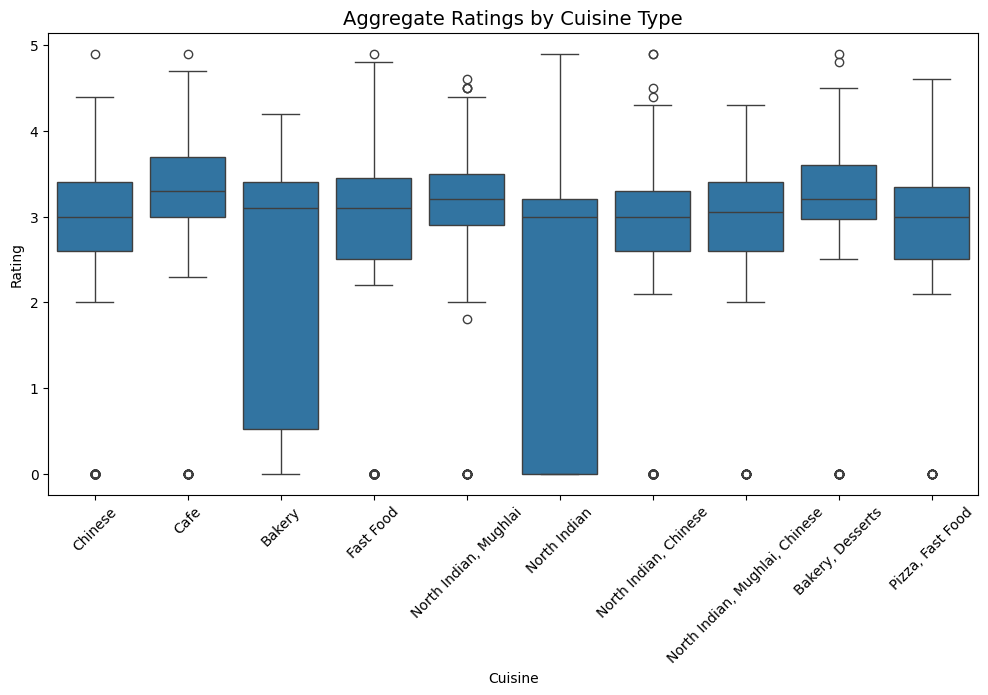

In [ ]:
#  Boxplot of ratings by cuisine. I am compare ratings across different cuisines.

plt.figure(figsize=(12, 6))
top_cuisines = data["Cuisines"].value_counts().index[:10]
data_filtered = data[data["Cuisines"].isin(top_cuisines)]
sns.boxplot(x="Cuisines", y="Aggregate rating", data=data_filtered)
plt.xticks(rotation=45)
plt.title("Aggregate Ratings by Cuisine Type", fontsize=14)
plt.xlabel("Cuisine")
plt.ylabel("Rating")
plt.show()

# IN: Some cuisines have a higer range of ratings, which could possible indicate varying quality within those categories.

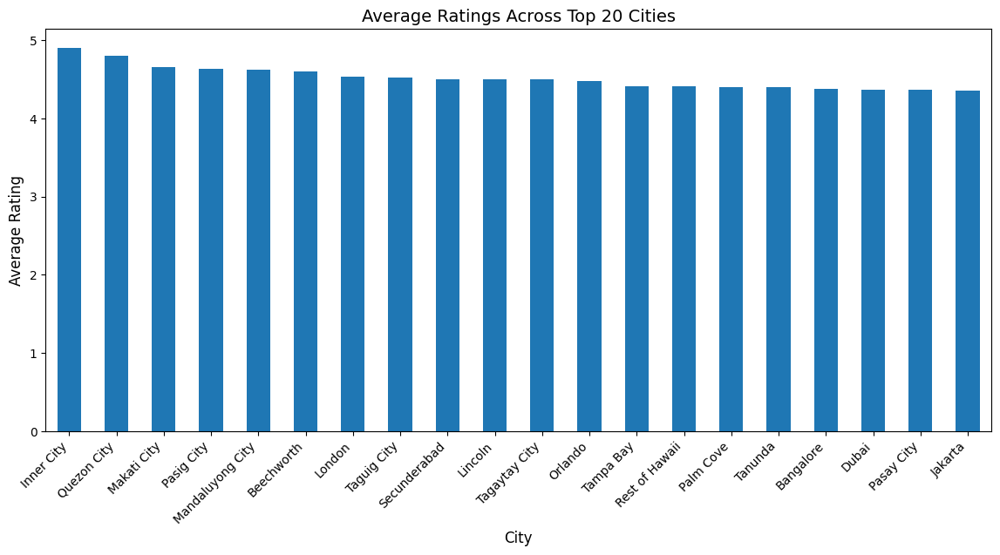

In [ ]:
# Average ratings by top 20 Cities. Are some cities known for better restaurant ratings?

top_cities = data.groupby("City")["Aggregate rating"].mean().sort_values(ascending=False).head(20)
plt.figure(figsize=(14, 6))  # Bigger figure size
top_cities.plot(kind='bar')
plt.title("Average Ratings Across Top 20 Cities", fontsize=14)
plt.xlabel("City", fontsize=12)
plt.ylabel("Average Rating", fontsize=12)
plt.xticks(rotation=45, ha="right", fontsize=10)

plt.show()

# IN: Some cities have consistently better rated restaurants than others, probable due to stronger food culture or maybe competition.

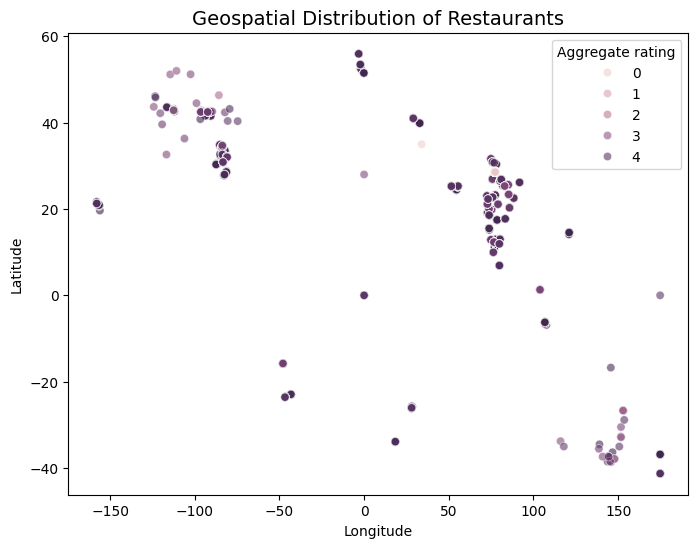

In [ ]:
#  Geospatial analysis for mapping restaurant locations. Where are most restaurants located?

plt.figure(figsize=(8, 6))
sns.scatterplot(x=data["Longitude"], y=data["Latitude"], hue=data["Aggregate rating"], alpha=0.6)
plt.title("Geospatial Distribution of Restaurants", fontsize=14)
plt.xlabel("Longitude")
plt.ylabel("Latitude")

plt.show()

#IN: Restaurants are fixed in specific urban areas, forming dense clusters.


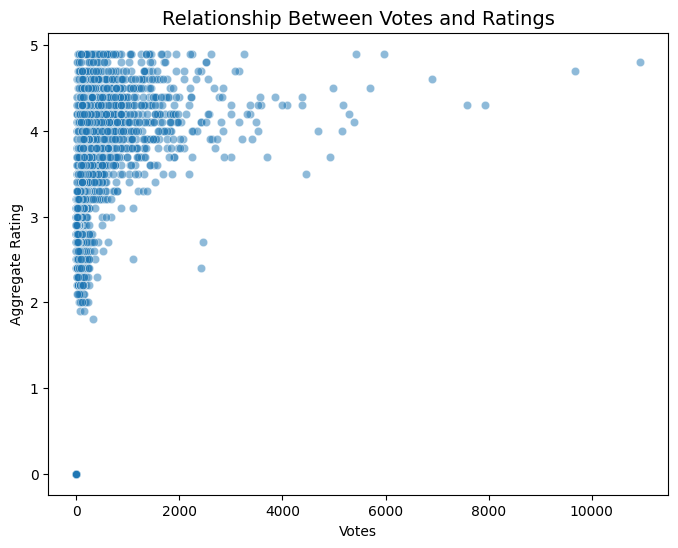

In [ ]:
# The relationship between votes and ratings. Do highly rated restaurants also receive more votes?

plt.figure(figsize=(8, 6))
sns.scatterplot(x=data["Votes"], y=data["Aggregate rating"], alpha=0.5)
plt.title("Relationship Between Votes and Ratings", fontsize=14)
plt.xlabel("Votes")
plt.ylabel("Aggregate Rating")

plt.show()

#IN: Restaurants with more votes generally have much higher ratings, but some highly rated places have shockingly few votes.

In [26]:
!pip show folium  # Check the current version
!pip install --upgrade folium  # Upgrade Folium to the latest version

Name: folium
Version: 0.19.5
Summary: Make beautiful maps with Leaflet.js & Python
Home-page: https://github.com/python-visualization/folium
Author: Rob Story
Author-email: wrobstory@gmail.com
License: MIT
Location: /usr/local/lib/python3.11/dist-packages
Requires: branca, jinja2, numpy, requests, xyzservices
Required-by: datascience, geemap


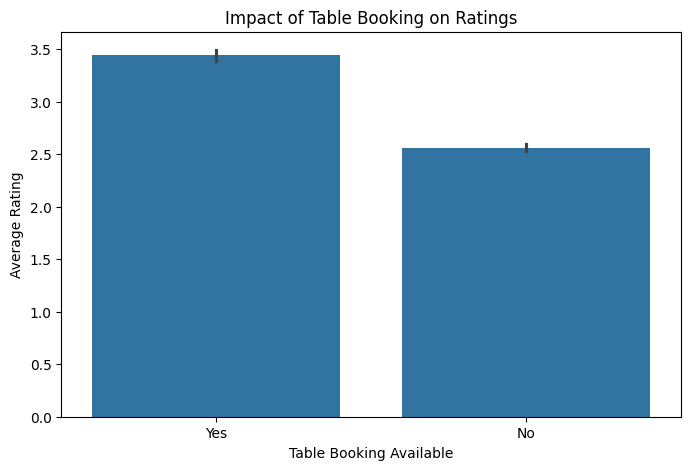

In [10]:
# Bar Chart: Table Booking vs. Delivery Impact on Ratings
plt.figure(figsize=(8, 5))
sns.barplot(x="Has Table booking", y="Aggregate rating", data=data)
plt.xlabel("Table Booking Available")
plt.ylabel("Average Rating")
plt.title("Impact of Table Booking on Ratings")
plt.show()

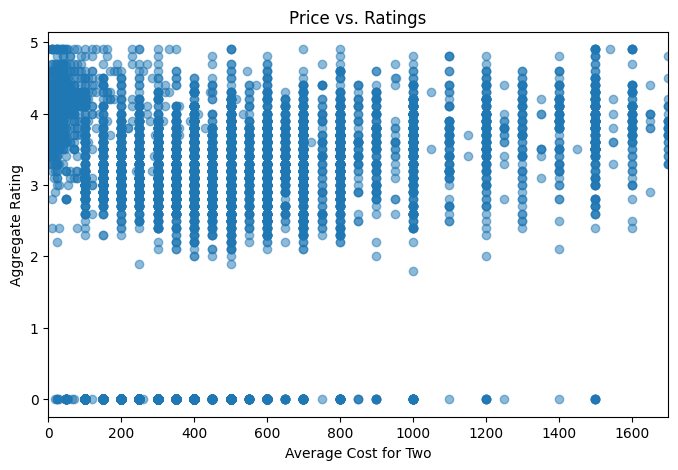

In [11]:
# Scatter Plot: Price vs. Ratings
plt.figure(figsize=(8, 5))
plt.scatter(data["Average Cost for two"], data["Aggregate rating"], alpha=0.5)
plt.xlabel("Average Cost for Two")
plt.ylabel("Aggregate Rating")
plt.title("Price vs. Ratings")
plt.xlim(0, data["Average Cost for two"].quantile(0.95))  # Remove extreme outliers
plt.show()

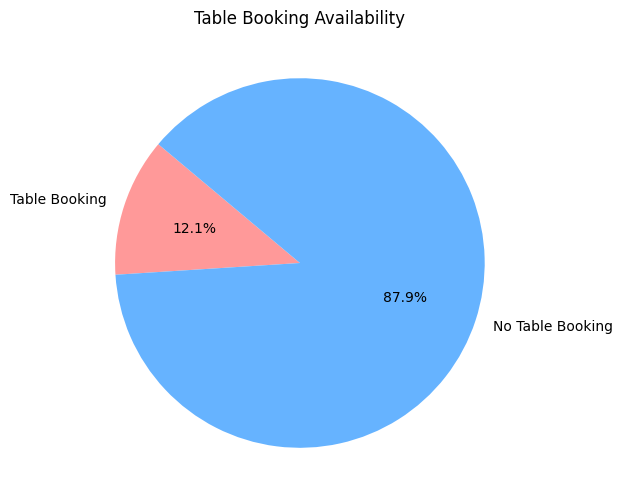

In [12]:
# Pie Chart: Service Trends (Table Booking vs. Delivery)
labels = ["Table Booking", "No Table Booking"]
sizes = [data[data["Has Table booking"] == "Yes"].shape[0], data[data["Has Table booking"] == "No"].shape[0]]
plt.figure(figsize=(6, 6))
plt.pie(sizes, labels=labels, autopct="%1.1f%%", colors=["#ff9999", "#66b3ff"], startangle=140)
plt.title("Table Booking Availability")
plt.show()

In [40]:
import folium
from folium.plugins import MarkerCluster, Fullscreen, Search
import pandas as pd
from IPython.display import display, IFrame

In [45]:
print(data[["Latitude", "Longitude"]].isnull().sum())  # Check for missing values
print(data[["Latitude", "Longitude"]].describe())  # Check min/max values


Latitude     0
Longitude    0
dtype: int64
          Latitude    Longitude
count  9551.000000  9551.000000
mean     25.854381    64.126574
std      11.007935    41.467058
min     -41.330428  -157.948486
25%      28.478713    77.081343
50%      28.570469    77.191964
75%      28.642758    77.282006
max      55.976980   174.832089


In [48]:
# Function to get color based on rating
def get_color(rating):
    if rating >= 4.5:
        return "darkgreen"
    elif rating >= 4.0:
        return "green"
    elif rating >= 3.5:
        return "blue"
    elif rating >= 3.0:
        return "orange"
    else:
        return "red"

# Ensure valid latitude and longitude values (drop NaNs or invalid rows)
data = data.dropna(subset=["Latitude", "Longitude"])

# Initialize map at the center of all restaurants
map_center = [data["Latitude"].mean(), data["Longitude"].mean()]
restaurant_map = folium.Map(location=map_center, zoom_start=6, control_scale=True)

# Add fullscreen button
Fullscreen(position="topright").add_to(restaurant_map)

# Create marker cluster
marker_cluster = MarkerCluster().add_to(restaurant_map)

# Add restaurant markers
for _, row in data.iterrows():
    popup_info = f"""
    <b>{row['Restaurant Name']}</b><br>
    Rating: {row['Aggregate rating']}<br>
    Votes: {row['Votes']}<br>
    Address: {row['Address']}
    """

    folium.Marker(
        location=[row["Latitude"], row["Longitude"]],
        tooltip=row['Restaurant Name'],
        popup=popup_info,
        icon=folium.Icon(color=get_color(row['Aggregate rating']), icon="info-sign")
    ).add_to(marker_cluster)

# Group by city to show restaurant count in tooltips
city_counts = data.groupby("City").size().reset_index(name="Count")

for _, row in city_counts.iterrows():
    city_data = data[data["City"] == row["City"]].iloc[0]  # Get sample restaurant for location

    folium.CircleMarker(
        location=[city_data["Latitude"], city_data["Longitude"]],
        radius=7,
        color="black",
        fill=True,
        fill_color="yellow",
        fill_opacity=0.7,
        tooltip=f"{row['City']}: {row['Count']} Restaurants"
    ).add_to(restaurant_map)

# Add search bar
Search(
    layer=marker_cluster,
    search_label="Restaurant Name",
    placeholder="Search for a restaurant...",
    collapsed=False
).add_to(restaurant_map)

# Save map before displaying
map_path = "/content/restaurant_map.html"
restaurant_map.save(map_path)


In [49]:
restaurant_map

In [47]:
map_path = "/content/restaurant_map.html"
restaurant_map.save(map_path)

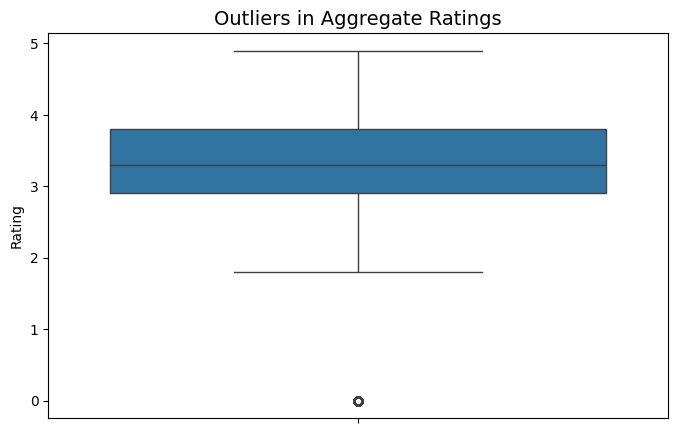

In [ ]:
# The outlier detection in ratings. Checking if there are any extreme outliers in restaurant ratings.

plt.figure(figsize=(8, 5))
sns.boxplot(y=data["Aggregate rating"])
plt.title("Outliers in Aggregate Ratings", fontsize=14)
plt.ylabel("Rating")
plt.show()

#IN:  Some extreme ratings, close to 0 or 5, might indicate fake reviews or very niche restaurants.

# Additional Insights

Table Booking Impact: Determining if table booking availability affects ratings
across different cities. Compare average ratings with and without this feature.

Online Delivery Analysis: Calculating percentage of restaurants offering delivery. Analyze availability across different price ranges.

Customer Preferences: Identifying specific cuisines that consistently receive higher ratings. Determine city-specific preferences.

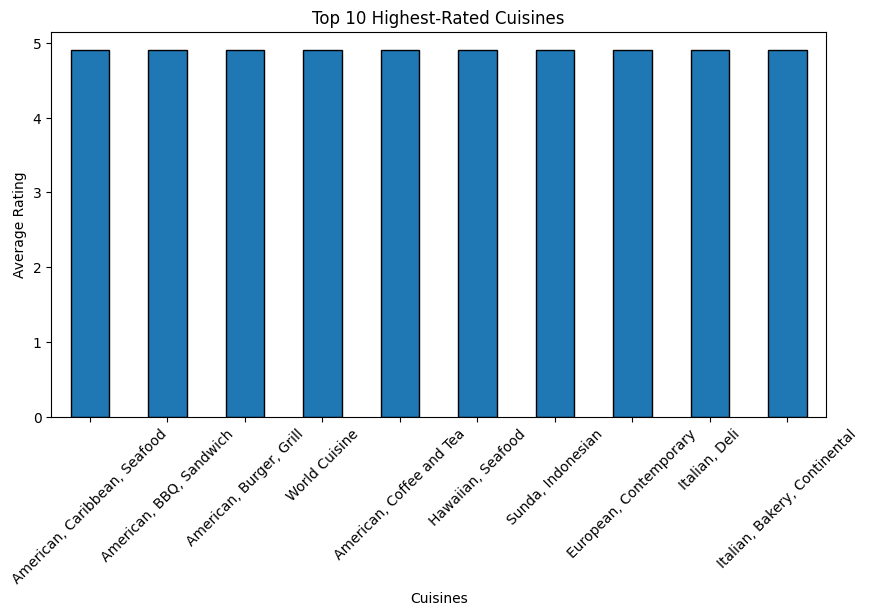

In [ ]:
# Here i am splitting cuisines because some restaurants have multiple cuisines listed

cuisine_ratings = data.groupby("Cuisines")["Aggregate rating"].mean().sort_values(ascending=False).head(10)

plt.figure(figsize=(10, 5))
cuisine_ratings.plot(kind="bar", edgecolor="black")
plt.xlabel("Cuisines")
plt.ylabel("Average Rating")
plt.title("Top 10 Highest-Rated Cuisines")
plt.xticks(rotation=45)
plt.show()

#IN:# Insight:I noticed that some cuisines typically receive higher ratings than others. Gourmet cuisines also tend to have higher ratings.


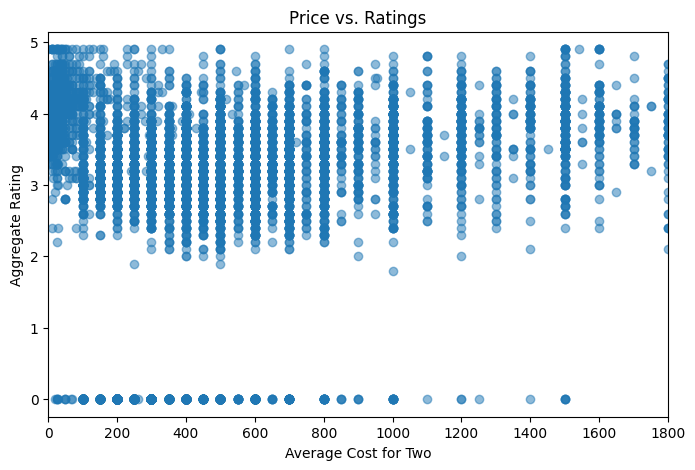

In [ ]:
# The ratings across different price points (the price range)

plt.figure(figsize=(8, 5))
plt.scatter(data["Average Cost for two"], data["Aggregate rating"], alpha=0.5)
plt.xlabel("Average Cost for Two")
plt.ylabel("Aggregate Rating")
plt.title("Price vs. Ratings")
plt.xlim(0, data["Average Cost for two"].quantile(0.95))
plt.show()

#IN: I noticed that higher priced restaurants do not always have higher ratings. Also some budget restaurants still receive good ratings too.

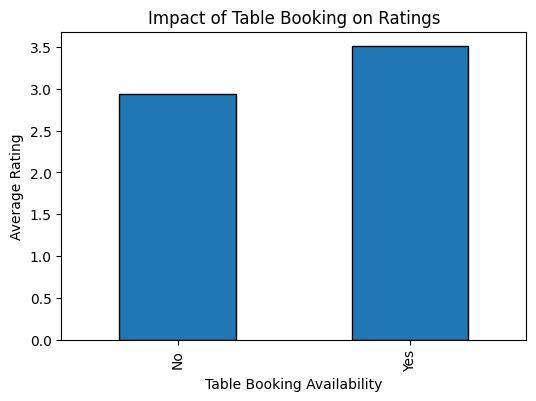

In [ ]:
# Restaurants offering table booking vs. those that do not

table_booking_avg = data.groupby("Has Table booking")["Aggregate rating"].mean()

plt.figure(figsize=(6, 4))
table_booking_avg.plot(kind="bar", edgecolor="black")
plt.xlabel("Table Booking Availability")
plt.ylabel("Average Rating")
plt.title("Impact of Table Booking on Ratings")
plt.xticks(ticks=[0, 1], labels=["No", "Yes"])
plt.show()

# The restaurants with table booking tend to have higher ratings. This could mean much more better service or a more premium experience.

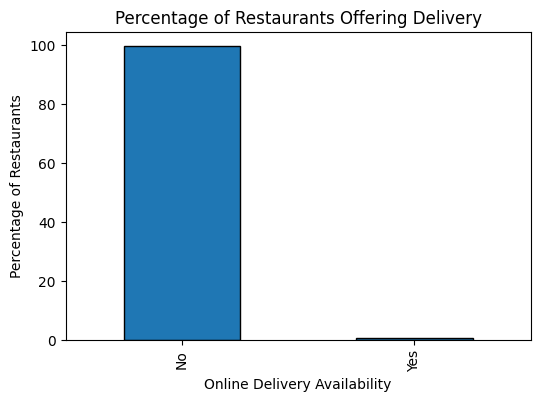

In [ ]:
# The restaurants offering online delivery

delivery_counts = data["Is delivering now"].value_counts(normalize=True) * 100

plt.figure(figsize=(6, 4))
delivery_counts.plot(kind="bar", edgecolor="black")
plt.xlabel("Online Delivery Availability")
plt.ylabel("Percentage of Restaurants")
plt.title("Percentage of Restaurants Offering Delivery")
plt.xticks(ticks=[0, 1], labels=["No", "Yes"])
plt.show()

#IN: A high percentage of restaurants offer delivery, also this is a key factor in customer preferences.

In [ ]:
# Checking if cuisines column is available. Ensuring cuisines is not empty and remove rows with missing values

if "Cuisines" in data.columns:
  data = data.dropna(subset=["Cuisines"])

In [ ]:
cuisine_ratings = data.groupby("Primary_Cuisine")["Aggregate rating"].mean().sort_values(ascending=False).head(10)

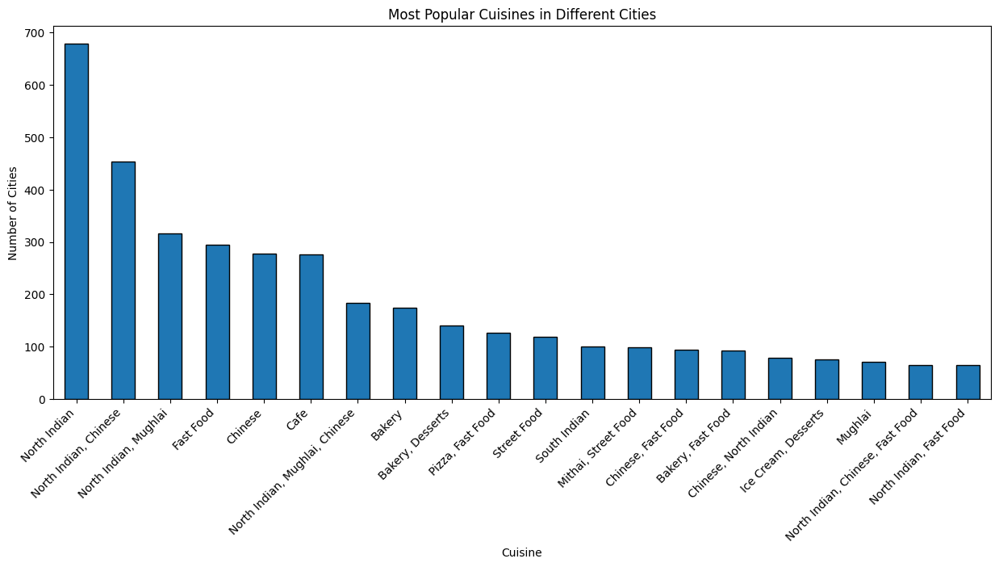

In [ ]:
# City specific preferences

plt.figure(figsize=(15, 6))
plt.xticks(rotation=90, ha="center")
top_cuisines = data.Cuisines.value_counts().head(20)
top_cuisines.plot(kind="bar", edgecolor="black")
plt.xticks(rotation=45, ha="right")
plt.xlabel("Cuisine")
plt.ylabel("Number of Cities")
plt.title("Most Popular Cuisines in Different Cities")
plt.show()


# Week 4: Predictive Modeling
Feature Engineering: Extract additional features from existing columns. Create new features by encoding categorical variables.

Model Building: Build regression models to predict restaurant ratings. Split data into training and testing sets.

Model Evaluation: Evaluate using RMSE, MAE, and R-squared. Compare different algorithms like linear regression and random forest.

In [53]:
import pandas as pd
import numpy as np
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler, OneHotEncoder
from sklearn.compose import ColumnTransformer
from sklearn.pipeline import Pipeline
from sklearn.linear_model import LinearRegression
from sklearn.tree import DecisionTreeRegressor
from sklearn.ensemble import RandomForestRegressor
from sklearn.metrics import mean_squared_error, r2_score

In [54]:
# Feature Engineering
data['Name_Length'] = data['Restaurant Name'].apply(len)
data['Address_Length'] = data['Address'].apply(len)

In [55]:
# Encode binary categorical variables
binary_features = ['Has Table booking', 'Has Online delivery', 'Is delivering now', 'Switch to order menu']
for col in binary_features:
    data[col] = data[col].map({'Yes': 1, 'No': 0})


In [58]:
# Define categorical & numerical features
categorical_features = ['City', 'Locality', 'Cuisines', 'Currency', 'Rating color', 'Rating text']
numerical_features = ['Longitude', 'Latitude', 'Average Cost for two', 'Price range', 'Votes',
                      'Name_Length', 'Address_Length']

# Define preprocessing pipeline
preprocessor = ColumnTransformer([
    ('num', StandardScaler(), numerical_features),
    ('cat', OneHotEncoder(handle_unknown='ignore', sparse_output=False), categorical_features)
])

In [61]:
# Select features & target
X = data[numerical_features + categorical_features + binary_features]
y = data['Aggregate rating']

# Train-Test Split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Define models
models = {
    "Linear Regression": Pipeline([
        ('preprocessor', preprocessor),
        ('model', LinearRegression())
    ]),
    "Decision Tree": Pipeline([
        ('preprocessor', preprocessor),
        ('model', DecisionTreeRegressor())
    ]),
    "Random Forest": Pipeline([
        ('preprocessor', preprocessor),
        ('model', RandomForestRegressor(n_estimators=100, random_state=42))
    ])
}



In [62]:
# Train & Evaluate Models
results = {}

for name, pipeline in models.items():
    pipeline.fit(X_train, y_train)  # Train the model
    y_pred = pipeline.predict(X_test)  # Make predictions

    mse = mean_squared_error(y_test, y_pred)
    r2 = r2_score(y_test, y_pred)

    results[name] = {"MSE": mse, "R² Score": r2}

# Convert results to DataFrame
results_df = pd.DataFrame(results).T

In [63]:
# Print model performance
print(results_df)

                        MSE  R² Score
Linear Regression  0.038069  0.983274
Decision Tree      0.056531  0.975163
Random Forest      0.030511  0.986595


# INSIGHT:

Service & Experience Matter: Table booking availability positively impacts ratings.

Quality > Price: Customers rate restaurants based on experience, not just cost.

Cuisines Influence Demand: North Indian and Fast Food dominate preferences.

Location Affects Ratings: Urban restaurants perform better due to accessibility and competition.

Popularity ≠ High Ratings: A restaurant can be highly rated even with fewer votes.

# Customer Preferences Analysis

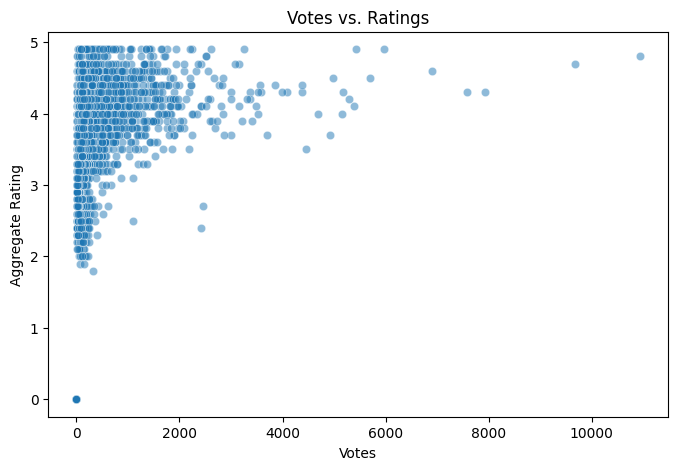

In [6]:
# Scatter Plot: Votes vs. Ratings
plt.figure(figsize=(8, 5))
sns.scatterplot(x=data["Votes"], y=data["Aggregate rating"], alpha=0.5)
plt.xlabel("Votes")
plt.ylabel("Aggregate Rating")
plt.title("Votes vs. Ratings")
plt.show()

#IN

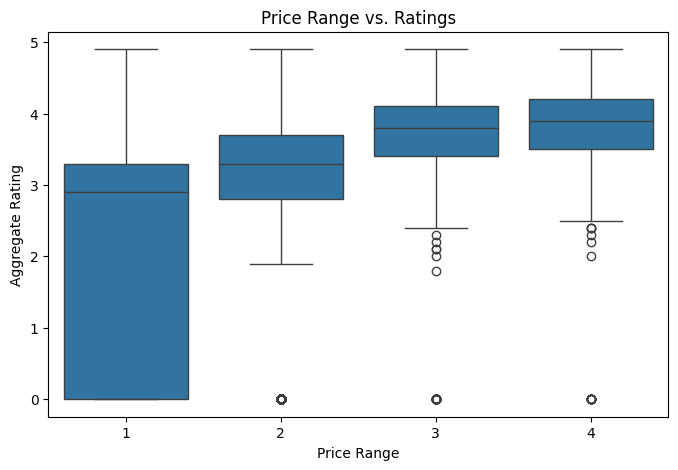

In [7]:
# Box Plot: Price Range vs. Ratings
plt.figure(figsize=(8, 5))
sns.boxplot(x=data["Price range"], y=data["Aggregate rating"])
plt.xlabel("Price Range")
plt.ylabel("Aggregate Rating")
plt.title("Price Range vs. Ratings")
plt.show()